In [1]:
import pandas as pd
import torch
import torch.nn as nn
import numpy as np
import joblib
from bayes_opt import BayesianOptimization
import pandas as pd

In [2]:
male_teams = pd.read_csv("male_teams.csv")

In [3]:
male_teams.head()

,team_id,team_url,fifa_version,fifa_update,update_as_of,team_name,league_id,league_name,league_level,nationality_id,...,off_corners,off_free_kicks,build_up_play_speed,build_up_play_dribbling,build_up_play_passing,build_up_play_positioning,chance_creation_passing,chance_creation_crossing,chance_creation_shooting,chance_creation_positioning
0,10,/team/10/manchester-city/240002,24,2,2023-09-22,Manchester City,13,Premier League,1.0,14,...,3.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,243,/team/243/real-madrid/240002,24,2,2023-09-22,Real Madrid,53,La Liga,1.0,45,...,3.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1318,/team/1318/england/240002,24,2,2023-09-22,England,78,Friendly International,NaN,14,...,3.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,21,/team/21/fc-bayern-munchen/240002,24,2,2023-09-22,FC Bayern München,19,Bundesliga,1.0,21,...,3.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,241,/team/241/fc-barcelona/240002,24,2,2023-09-22,FC Barcelona,53,La Liga,1.0,45,...,3.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
team_name = "FC Barcelona"

In [5]:
import pandas as pd

# Assuming you have the male_teams dataset loaded
# Replace this with the actual loading code if needed
# Example: male_teams = pd.read_csv('male_teams.csv')

# Function to extract international and domestic prestige for a specific team
def extract_prestige(male_teams, team_name):
    # Filter the dataset for the team
    team_data = male_teams[male_teams['team_name'] == team_name]
    
    if team_data.empty:
        print(f"Team {team_name} not found in the dataset.")
        return None, None
    
    # Extract international and domestic prestige
    international_prestige = team_data['international_prestige'].values[0]
    domestic_prestige = team_data['domestic_prestige'].values[0]
    
    return international_prestige, domestic_prestige


In [6]:

# Extract prestige values for FC Barcelona
international_prestige, domestic_prestige = extract_prestige(male_teams, team_name)

# Output the results
print(f"International Prestige: {international_prestige}")
print(f"Domestic Prestige: {domestic_prestige}")


International Prestige: 10
Domestic Prestige: 10.0


In [7]:
import warnings
warnings.filterwarnings("ignore")

In [8]:
data = pd.read_csv('Players 2024.csv')

In [9]:
pd.set_option('display.max_columns', None) 

In [10]:
data.head()

,Unnamed: 0,short_name,long_name,player_positions,overall,club_name,club_position,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,PossessionPlay_striker,PossessionPlay_center_forward,PossessionPlay_winger,PossessionPlay_attacking_midfielder,PossessionPlay_central_midfielder,PossessionPlay_wide_midfielder,PossessionPlay_defensive_midfielder,PossessionPlay_full_back,PossessionPlay_wing_back,PossessionPlay_center_back,CounterAttack_striker,CounterAttack_center_forward,CounterAttack_winger,CounterAttack_attacking_midfielder,CounterAttack_central_midfielder,CounterAttack_wide_midfielder,CounterAttack_defensive_midfielder,CounterAttack_full_back,CounterAttack_wing_back,CounterAttack_center_back,HighPress_striker,HighPress_center_forward,HighPress_winger,HighPress_attacking_midfielder,HighPress_central_midfielder,HighPress_wide_midfielder,HighPress_defensive_midfielder,HighPress_full_back,HighPress_wing_back,HighPress_center_back,DirectPlay_striker,DirectPlay_center_forward,DirectPlay_winger,DirectPlay_attacking_midfielder,DirectPlay_central_midfielder,DirectPlay_wide_midfielder,DirectPlay_defensive_midfielder,DirectPlay_full_back,DirectPlay_wing_back,DirectPlay_center_back,WingPlay_striker,WingPlay_center_forward,WingPlay_winger,WingPlay_attacking_midfielder,WingPlay_central_midfielder,WingPlay_wide_midfielder,WingPlay_defensive_midfielder,WingPlay_full_back,WingPlay_wing_back,WingPlay_center_back,SetPieceFocus_striker,SetPieceFocus_center_forward,SetPieceFocus_winger,SetPieceFocus_attacking_midfielder,SetPieceFocus_central_midfielder,SetPieceFocus_wide_midfielder,SetPieceFocus_defensive_midfielder,SetPieceFocus_full_back,SetPieceFocus_wing_back,SetPieceFocus_center_back,CreativePlaymaking_striker,CreativePlaymaking_center_forward,CreativePlaymaking_winger,CreativePlaymaking_attacking_midfielder,CreativePlaymaking_central_midfielder,CreativePlaymaking_wide_midfielder,CreativePlaymaking_defensive_midfielder,CreativePlaymaking_full_back,CreativePlaymaking_wing_back,CreativePlaymaking_center_back,PlayingOutFromTheBack_striker,PlayingOutFromTheBack_center_forward,PlayingOutFromTheBack_winger,PlayingOutFromTheBack_attacking_midfielder,PlayingOutFromTheBack_central_midfielder,PlayingOutFromTheBack_wide_midfielder,PlayingOutFromTheBack_defensive_midfielder,PlayingOutFromTheBack_full_back,PlayingOutFromTheBack_wing_back,PlayingOutFromTheBack_center_back,LowBlock_striker,LowBlock_center_forward,LowBlock_winger,LowBlock_attacking_midfielder,LowBlock_central_midfielder,LowBlock_wide_midfielder,LowBlock_defensive_midfielder,LowBlock_full_back,LowBlock_wing_back,LowBlock_center_back,HighDefensiveLine_striker,HighDefensiveLine_center_forward,HighDefensiveLine_winger,HighDefensiveLine_attacking_midfielder,HighDefensiveLine_central_midfielder,HighDefensiveLine_wide_midfielder,HighDefensiveLine_defensive_midfielder,HighDefensiveLine_full_back,HighDefensiveLine_wing_back,HighDefensiveLine_center_back
0,0,K. Mbappé,Kylian Mbappé Lottin,"ST, LW",91,Paris Saint Germain,LW,90+3,90+3,90+3,91,91,91,91,91,89+3,89+3,89+3,89+3,81+3,81+3,81+3,89+3,68+3,63+3,63+3,63+3,68+3,63+3,54+3,54+3,54+3,63+3,18+3,90.6,88.6,89.8,88.2,71.5,89.3,63.9,81.9,81.2,63.0,81.3,82.5,91.5,89.4,87.7,91.5,65.8,77.6,83.9,63.9,61.5,63.9,70.9,60.1,51.6,61.0,38.1,60.2,59.3,38.9,58.6,59.0,88.7,67.0,50.5,87.1,47.5,67.2,63.7,55.7,62.7,62.9,88.7,67.5,58.9,80.3,55.5,67.6,74.3,55.7,50.6,50.6,86.3,68.5,64.9,77.9,55.5,64.2,74.1,46.4,62.5,61.7,71.7,61.7,60.4,79.0,52.5,59.0,79.8,46.9,63.2,70.8,72.1,60.6,53.6,70.6,47.3,59.4,67.1,46.9,26.0,34.2,55.1,35.0,26.0,44.2,29.4,40.8,42.4,31.3,62.8,61.8,63.3,51.6,44.4,62.7,38.1,59.9,57.9,32.2
1,1,E. Haaland,Erling Braut Haaland,ST,91,Manchester City,ST,90+3,90+3,90+3,82,86,86,86,82,82+3,82+3,82+3,79+3,74+3,74+3,74+3,79+3,62+3,63+3,63+3,63+3,62+3,60+3,62+3,62+3,62+3,60+3,19+3,87.6,80.9,79.9,80.8,65.6,78.6,61.6,72.0,74.0,65.4,80.1,79.1,81.6,82.5,80.8,81.6,64.3,69.5,76.6,66.1,62.0,62.0,64.8,56.9,49.9,54.4,39.1,60.4,57.9

In [11]:
df = data

In [12]:
df = data

# Function to convert position overall strings like "54+2" into integers
def parse_overall(overall):

    if isinstance(overall, str) and '+' in overall:
        base, bonus = map(int, overall.split('+'))
        return base + bonus
    if isinstance(overall, str) and '-' in overall:
        base, bonus = map(int, overall.split('-'))
        return base - bonus
    
    return int(overall)

# List of positions
positions = ["ls", "st", "rs", "lw", "lf", "cf", "rf", "rw", "lam", "cam", "ram", "lm", "lcm", "cm", "rcm", "rm", 
             "lwb", "ldm", "cdm", "rdm", "rwb", "lb", "lcb", "cb", "rcb", "rb", "gk"]

# Calculate total overall for each position
for position in positions:
    df[f'{position}_overall'] = df.apply(lambda x: parse_overall(x[position]) ,axis=1)

# List of columns to remove
columns_to_remove = ['ls', 'st', 'rs', 'lw', 'lf', 'cf', 'rf', 'rw', 'lam', 'cam', 'ram',
    'lm', 'lcm', 'cm', 'rcm', 'rm', 'lwb', 'ldm', 'cdm', 'rdm', 'rwb', 'lb', 'lcb', 'cb',
    'rcb', 'rb', 'gk', "Unnamed: 0"
]

# Remove the columns
data = data.drop(columns=columns_to_remove)


In [13]:
pd.set_option('display.max_columns', None)

In [14]:
import pandas as pd

# Assuming your data is stored in a DataFrame called 'data'
data.fillna(0, inplace=True)

In [15]:
data.head(10)

,short_name,long_name,player_positions,overall,club_name,club_position,PossessionPlay_striker,PossessionPlay_center_forward,PossessionPlay_winger,PossessionPlay_attacking_midfielder,PossessionPlay_central_midfielder,PossessionPlay_wide_midfielder,PossessionPlay_defensive_midfielder,PossessionPlay_full_back,PossessionPlay_wing_back,PossessionPlay_center_back,CounterAttack_striker,CounterAttack_center_forward,CounterAttack_winger,CounterAttack_attacking_midfielder,CounterAttack_central_midfielder,CounterAttack_wide_midfielder,CounterAttack_defensive_midfielder,CounterAttack_full_back,CounterAttack_wing_back,CounterAttack_center_back,HighPress_striker,HighPress_center_forward,HighPress_winger,HighPress_attacking_midfielder,HighPress_central_midfielder,HighPress_wide_midfielder,HighPress_defensive_midfielder,HighPress_full_back,HighPress_wing_back,HighPress_center_back,DirectPlay_striker,DirectPlay_center_forward,DirectPlay_winger,DirectPlay_attacking_midfielder,DirectPlay_central_midfielder,DirectPlay_wide_midfielder,DirectPlay_defensive_midfielder,DirectPlay_full_back,DirectPlay_wing_back,DirectPlay_center_back,WingPlay_striker,WingPlay_center_forward,WingPlay_winger,WingPlay_attacking_midfielder,WingPlay_central_midfielder,WingPlay_wide_midfielder,WingPlay_defensive_midfielder,WingPlay_full_back,WingPlay_wing_back,WingPlay_center_back,SetPieceFocus_striker,SetPieceFocus_center_forward,SetPieceFocus_winger,SetPieceFocus_attacking_midfielder,SetPieceFocus_central_midfielder,SetPieceFocus_wide_midfielder,SetPieceFocus_defensive_midfielder,SetPieceFocus_full_back,SetPieceFocus_wing_back,SetPieceFocus_center_back,CreativePlaymaking_striker,CreativePlaymaking_center_forward,CreativePlaymaking_winger,CreativePlaymaking_attacking_midfielder,CreativePlaymaking_central_midfielder,CreativePlaymaking_wide_midfielder,CreativePlaymaking_defensive_midfielder,CreativePlaymaking_full_back,CreativePlaymaking_wing_back,CreativePlaymaking_center_back,PlayingOutFromTheBack_striker,PlayingOutFromTheBack_center_forward,PlayingOutFromTheBack_winger,PlayingOutFromTheBack_attacking_midfielder,PlayingOutFromTheBack_central_midfielder,PlayingOutFromTheBack_wide_midfielder,PlayingOutFromTheBack_defensive_midfielder,PlayingOutFromTheBack_full_back,PlayingOutFromTheBack_wing_back,PlayingOutFromTheBack_center_back,LowBlock_striker,LowBlock_center_forward,LowBlock_winger,LowBlock_attacking_midfielder,LowBlock_central_midfielder,LowBlock_wide_midfielder,LowBlock_defensive_midfielder,LowBlock_full_back,LowBlock_wing_back,LowBlock_center_back,HighDefensiveLine_striker,HighDefensiveLine_center_forward,HighDefensiveLine_winger,HighDefensiveLine_attacking_midfielder,HighDefensiveLine_central_midfielder,HighDefensiveLine_wide_midfielder,HighDefensiveLine_defensive_midfielder,HighDefensiveLine_full_back,HighDefensiveLine_wing_back,HighDefensiveLine_center_back,ls_overall,st_overall,rs_overall,lw_overall,lf_overall,cf_overall,rf_overall,rw_overall,lam_overall,cam_overall,ram_overall,lm_overall,lcm_overall,cm_overall,rcm_overall,rm_overall,lwb_overall,ldm_overall,cdm_overall,rdm_overall,rwb_overall,lb_overall,lcb_overall,cb_overall,rcb_overall,rb_overall,gk_overall
0,K. Mbappé,Kylian Mbappé Lottin,"ST, LW",91,Paris Saint Germain,LW,90.6,88.6,89.8,88.2,71.5,89.3,63.9,81.9,81.2,63.0,81.3,82.5,91.5,89.4,87.7,91.5,65.8,77.6,83.9,63.9,61.5,63.9,70.9,60.1,51.6,61.0,38.1,60.2,59.3,38.9,58.6,59.0,88.7,67.0,50.5,87.1,47.5,67.2,63.7,55.7,62.7,62.9,88.7,67.5,58.9,80.3,55.5,67.6,74.3,55.7,50.6,50.6,86.3,68.5,64.9,77.9,55.5,64.2,74.1,46.4,62.5,61.7,71.7,61.7,60.4,79.0,52.5,59.0,79.8,46.9,63.2,70.8,72.1,60.6,53.6,70.6,47.3,59.4,67.1,46.9,26.0,34.2,55.1,35.0,26.0,44.2,29.4,40.8,42.4,31.3,62.8,61.8,63.3,51.6,44.4,62.7,38.1,59.9,57.9,32.2,93,93,93,91,91,91,91,91,92,92,92,92,84,84,84,92,71,66,66,66,71,66,57,57,57,66,21
1,E. Haaland,Erling Braut Haaland,ST,91,Manchester City,ST,87.6,80.9,79.9,80.8,65.6,78.6,61.6,72.0,74.0,65.4,80.1,79.1,81.6,82.5,80.8,81.6,64.3,69.5,76.6,66.1,62.0,62.0,64

In [16]:
df = data[data['club_name'] == team_name]

In [17]:
data = df
data.head(30)

,short_name,long_name,player_positions,overall,club_name,club_position,PossessionPlay_striker,PossessionPlay_center_forward,PossessionPlay_winger,PossessionPlay_attacking_midfielder,PossessionPlay_central_midfielder,PossessionPlay_wide_midfielder,PossessionPlay_defensive_midfielder,PossessionPlay_full_back,PossessionPlay_wing_back,PossessionPlay_center_back,CounterAttack_striker,CounterAttack_center_forward,CounterAttack_winger,CounterAttack_attacking_midfielder,CounterAttack_central_midfielder,CounterAttack_wide_midfielder,CounterAttack_defensive_midfielder,CounterAttack_full_back,CounterAttack_wing_back,CounterAttack_center_back,HighPress_striker,HighPress_center_forward,HighPress_winger,HighPress_attacking_midfielder,HighPress_central_midfielder,HighPress_wide_midfielder,HighPress_defensive_midfielder,HighPress_full_back,HighPress_wing_back,HighPress_center_back,DirectPlay_striker,DirectPlay_center_forward,DirectPlay_winger,DirectPlay_attacking_midfielder,DirectPlay_central_midfielder,DirectPlay_wide_midfielder,DirectPlay_defensive_midfielder,DirectPlay_full_back,DirectPlay_wing_back,DirectPlay_center_back,WingPlay_striker,WingPlay_center_forward,WingPlay_winger,WingPlay_attacking_midfielder,WingPlay_central_midfielder,WingPlay_wide_midfielder,WingPlay_defensive_midfielder,WingPlay_full_back,WingPlay_wing_back,WingPlay_center_back,SetPieceFocus_striker,SetPieceFocus_center_forward,SetPieceFocus_winger,SetPieceFocus_attacking_midfielder,SetPieceFocus_central_midfielder,SetPieceFocus_wide_midfielder,SetPieceFocus_defensive_midfielder,SetPieceFocus_full_back,SetPieceFocus_wing_back,SetPieceFocus_center_back,CreativePlaymaking_striker,CreativePlaymaking_center_forward,CreativePlaymaking_winger,CreativePlaymaking_attacking_midfielder,CreativePlaymaking_central_midfielder,CreativePlaymaking_wide_midfielder,CreativePlaymaking_defensive_midfielder,CreativePlaymaking_full_back,CreativePlaymaking_wing_back,CreativePlaymaking_center_back,PlayingOutFromTheBack_striker,PlayingOutFromTheBack_center_forward,PlayingOutFromTheBack_winger,PlayingOutFromTheBack_attacking_midfielder,PlayingOutFromTheBack_central_midfielder,PlayingOutFromTheBack_wide_midfielder,PlayingOutFromTheBack_defensive_midfielder,PlayingOutFromTheBack_full_back,PlayingOutFromTheBack_wing_back,PlayingOutFromTheBack_center_back,LowBlock_striker,LowBlock_center_forward,LowBlock_winger,LowBlock_attacking_midfielder,LowBlock_central_midfielder,LowBlock_wide_midfielder,LowBlock_defensive_midfielder,LowBlock_full_back,LowBlock_wing_back,LowBlock_center_back,HighDefensiveLine_striker,HighDefensiveLine_center_forward,HighDefensiveLine_winger,HighDefensiveLine_attacking_midfielder,HighDefensiveLine_central_midfielder,HighDefensiveLine_wide_midfielder,HighDefensiveLine_defensive_midfielder,HighDefensiveLine_full_back,HighDefensiveLine_wing_back,HighDefensiveLine_center_back,ls_overall,st_overall,rs_overall,lw_overall,lf_overall,cf_overall,rf_overall,rw_overall,lam_overall,cam_overall,ram_overall,lm_overall,lcm_overall,cm_overall,rcm_overall,rm_overall,lwb_overall,ldm_overall,cdm_overall,rdm_overall,rwb_overall,lb_overall,lcb_overall,cb_overall,rcb_overall,rb_overall,gk_overall
5,R. Lewandowski,Robert Lewandowski,ST,90,FC Barcelona,ST,87.8,85.2,82.8,85.1,70.4,83.0,65.1,76.0,76.6,68.0,78.3,77.1,82.4,83.5,83.6,82.4,65.0,70.5,76.9,66.7,59.3,60.0,66.7,58.6,52.4,57.1,40.9,58.5,56.8,42.1,59.8,59.2,83.6,69.9,49.1,85.3,48.9,65.6,61.7,57.7,61.3,60.8,83.7,68.4,58.5,74.8,56.9,63.9,69.7,57.7,53.7,53.7,82.9,71.4,66.6,74.7,56.9,64.5,74.2,48.4,61.9,60.7,65.5,59.2,58.6,77.0,54.1,58.2,76.3,48.5,61.0,69.6,67.4,60.5,52.8,68.1,49.9,56.5,65.4,48.5,24.8,33.1,50.8,35.9,27.8,40.4,32.0,40.2,39.9,33.4,59.6,59.6,56.6,50.1,43.8,58.0,40.9,55.0,56.3,31.7,90,90,90,85,88,88,88,85,89,89,89,87,83,83,83,87,68,69,69,69,68,64,64,64,64,64,22
13,M. ter Stegen,Marc-André ter Stegen,GK,89,FC Barcelona,GK,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,41.6,0.0,0.0,0.0,0.0,0.0,33.

In [18]:
import pandas as pd

# Define the position categories
attack_positions = ['ST', 'CF', 'LW', 'RW', 'LS', 'RS', 'LF', 'RF']
midfield_positions = ['CAM', 'CM', 'CDM', 'LAM', 'RAM', 'LCM', 'RCM', 'LM', 'RM', 'LDM', 'RDM']
defense_positions = ['CB', 'LCB', 'RCB', 'LB', 'RB', 'LWB', 'RWB']
goalkeeper_position = ['GK']

# Function to calculate the overall team ratings
def calculate_team_ratings(df):
    # Initialize lists to store overall ratings for each position
    attack_overall = []
    midfield_overall = []
    defense_overall = []
    goalkeeper_overall = []
    
    # Iterate over each player and their positions
    for index, row in df.iterrows():
        # Skip players with 'RES' in club_position
        if row['club_position'] == 'RES':
            continue  # Skip this player

        player_positions = row['player_positions'].split(', ')  # Split positions by commas
        player_overall = row['overall']
        
        # Assign player's overall to each relevant position
        for position in player_positions:
            if position in attack_positions:
                attack_overall.append(player_overall)
            elif position in midfield_positions:
                midfield_overall.append(player_overall)
            elif position in defense_positions:
                defense_overall.append(player_overall)
            elif position in goalkeeper_position:
                goalkeeper_overall.append(player_overall)

    # Calculate the average overall rating for each section of the team
    home_attack = sum(attack_overall) / len(attack_overall) if attack_overall else 0
    home_midfield = sum(midfield_overall) / len(midfield_overall) if midfield_overall else 0
    home_defense = sum(defense_overall) / len(defense_overall) if defense_overall else 0
    home_goalkeeper = sum(goalkeeper_overall) / len(goalkeeper_overall) if goalkeeper_overall else 0
    
    # Calculate the total overall, considering all positions
    all_positions = attack_overall + midfield_overall + defense_overall + goalkeeper_overall
    home_overall = sum(all_positions) / len(all_positions) if all_positions else 0
    
    return home_overall, home_attack, home_midfield, home_defense, home_goalkeeper

# Assuming you have already loaded your dataset
# Call the function on your dataset
home_overall, home_attack, home_midfield, home_defense, home_goalkeeper = calculate_team_ratings(df)

# Output the calculated ratings
print(f"Home Overall: {home_overall}")
print(f"Home Attack: {home_attack}")
print(f"Home Midfield: {home_midfield}")
print(f"Home Defense: {home_defense}")
print(f"Home Goalkeeper: {home_goalkeeper}")


Home Overall: 80.0
Home Attack: 80.0
Home Midfield: 80.45454545454545
Home Defense: 79.58823529411765
Home Goalkeeper: 81.0


In [19]:
Home_Overall = home_overall
Home_Attack = home_attack
Home_Midfield = home_midfield
Home_Defense = home_defense

# Select Data

In [20]:
formations = pd.read_csv('Formations.csv')
formations.head()   

,Formation,Mode,Formation Base,Description,Available In,Counter Formations,GK,LCB,CB,RCB,RM,RCM,CDM,LCM,LM,LS,RS,RB,LB,RWB,LWB,CM,CAM,RW,LW,ST,CF,LF,RF,RAM,LAM,LDM,RDM
0,3-1-4-2,Attacking / Midfield (Moderate),3-5-2,Suitable for the games you’re trying to win an...,FUT / Career Mode / Kick-off / Tournaments,4-5-1 / 4-1-3-2,1,1,1,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,3-4-1-2,Attacking (Moderate),3-5-2,Suitable for the games you are trying to win b...,FUT / Career Mode / Kick-off / Tournaments,4-5-1,1,0,3,0,1,0,0,0,1,0,0,0,0,0,0,2,1,0,0,2,0,0,0,0,0,0,0
2,3-4-2-1,Attacking,3-4-3,A variation of 3-4-1-2 formation but more atta...,FUT / Career Mode / Kick-off / Tournaments,4-5-1 / 4-2-3-1,1,0,3,0,1,0,0,0,1,0,0,0,0,0,0,2,0,0,0,1,0,1,1,0,0,0,0
3,3-4-3 Diamond,Attacking,3-4-3,Suitable for the games where you want to conce...,Career Mode / Kick-off / Tournaments,4-3-1-2 / 4-2-3-1 / 5-3-2,1,1,1,1,1,0,1,0,1,0,0,0,0,0,0,0,1,1,1,1,0,0,0,0,0,0,0
4,3-4-3 Flat,Attacking,3-4-3,Suitable for the games where you want to conce...,Career Mode / Kick-off / Tournaments,4-3-1-2 / 4-2-3-1 / 5-3-2,1,1,1,1,1,1,0,1,1,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0


In [21]:
formations_df = formations
players_df = data

# Linear Optimization

# Genetic algorithm

# Early Stopping

In [22]:
import torch
import torch.nn as nn
import numpy as np
import joblib
from bayes_opt import BayesianOptimization
import pandas as pd

# Define the Deep Neural Network
class DeepNeuralNetwork(nn.Module):
    def __init__(self):
        super(DeepNeuralNetwork, self).__init__()
        self.fc1 = nn.Linear(32, 2048)
        self.fc2 = nn.Linear(2048, 1024)
        self.fc3 = nn.Linear(1024, 512)
        self.fc4 = nn.Linear(512, 256)
        self.fc5 = nn.Linear(256, 128)
        self.fc6 = nn.Linear(128, 64)
        self.fc7 = nn.Linear(64, 32)
        self.fc8 = nn.Linear(32, 1)
        self.relu = nn.ReLU()

    def forward(self, x):
        x = self.relu(self.fc1(x))
        x = self.relu(self.fc2(x))
        x = self.relu(self.fc3(x))
        x = self.relu(self.fc4(x))
        x = self.relu(self.fc5(x))
        x = self.relu(self.fc6(x))
        x = self.relu(self.fc7(x))
        x = self.fc8(x)
        x = torch.clamp(x, min=0, max=10)  # Ensure output is between 0 and 10
        return x

# Load the trained model
model = DeepNeuralNetwork()
model.load_state_dict(torch.load("/Users/farzammanafzadeh/Desktop/Tactics/First Phase/deep_neural_network.pth"))
model.eval()

# Load the scaler
scaler = joblib.load('/Users/farzammanafzadeh/Desktop/Tactics/First Phase/scaler.pkl')


In [23]:
import torch
import numpy as np
import joblib

# Define the feature names and the provided values
input_dict = {
    "home_overall": 84.0,
    "home_attack": 90.0,
    "home_midfield": 78.0,
    "home_defence": 84.0,
    "home_international_prestige": 10.0,
    "home_domestic_prestige": 10.0,
    "home_possession_play": 76.0,
    "home_counter_attack": 42.0,
    "home_high_press": 44.0,
    "home_direct_play": 39.0,
    "home_wing_play": 36.0,
    "home_set_piece_focus": 25.0,
    "home_creative_playmaking": 57.0,
    "home_playing_out_back": 59.0,
    "home_low_block": 50.0,
    "home_high_defensive_line": 35.0,
    "away_overall": 73.0,
    "away_attack": 76.0,
    "away_midfield": 73.0,
    "away_defence": 72.0,
    "away_international_prestige": 3.0,
    "away_domestic_prestige": 4.0,
    "away_possession_play": 45.0,
    "away_counter_attack": 14.0,
    "away_high_press": 24.0,
    "away_direct_play": 21.0,
    "away_wing_play": 26.0,
    "away_set_piece_focus": 55.0,
    "away_creative_playmaking": 34.0,
    "away_playing_out_back": 33.0,
    "away_low_block": 30.0,
    "away_high_defensive_line": 25.0
}

# Convert the dictionary to a NumPy array
manual_input = np.array(list(input_dict.values())).reshape(1, -1)

# Load the trained model
model = DeepNeuralNetwork()
model.load_state_dict(torch.load('/Users/farzammanafzadeh/Desktop/Tactics/First Phase/deep_neural_network.pth'))
model.eval()

# Load the scaler to normalize the manual input
scaler = joblib.load('/Users/farzammanafzadeh/Desktop/Tactics/First Phase/scaler.pkl')

# Normalize the input using the previously saved scaler
manual_input_scaled = scaler.transform(manual_input)

# Convert the input to a PyTorch tensor
manual_input_tensor = torch.tensor(manual_input_scaled, dtype=torch.float32)

# Make the prediction
with torch.no_grad():
    prediction = model(manual_input_tensor)

# Convert the prediction to a float and round to two decimal places
predicted_success_rate = round(prediction.item(), 2)

# Output the predicted success rate
print(f'Predicted Success Rate: {predicted_success_rate}')


Predicted Success Rate: 8.9


In [24]:
pip install bayesian-optimization


Note: you may need to restart the kernel to use updated packages.


# Test Against FC Barcelona

In [25]:
# Fixed away parameters
away_params_fixed = [ 80, 80, 80, 80, 10, 10,
    80, 20, 20, 90, 60, 20, 80, 10, 30, 50
]

In [26]:

home_tactical_features = [
    'home_possession_play', 'home_counter_attack', 'home_high_press', 'home_direct_play',
    'home_wing_play', 'home_set_piece_focus', 'home_creative_playmaking', 'home_playing_out_back',
    'home_low_block', 'home_high_defensive_line'
]

away_tactical_features = [
    'away_possession_play', 'away_counter_attack', 'away_high_press', 'away_direct_play',
    'away_wing_play', 'away_set_piece_focus', 'away_creative_playmaking', 'away_low_block',
    'away_high_defensive_line'
]

players_tactical_features = [
    'possession_play', 'counter_attack', 'high_press', 'direct_play',
    'wing_play', 'set_piece_focus', 'creative_playmaking', 'playing_out_back'
]


In [27]:
home_quality = [home_overall, home_attack, home_midfield, home_defense, international_prestige, domestic_prestige]

In [30]:
from bayes_opt import BayesianOptimization, UtilityFunction
import numpy as np
import torch

# Define the objective function to optimize
def predict_success_rate(possession_play, counter_attack, high_press, direct_play, wing_play,
                         set_piece_focus, creative_playmaking, playing_out_back, low_block, 
                         high_defensive_line):
    # Snap each parameter to the nearest multiple of 10
    rounded_params = [
        round(possession_play / 10) * 10,
        round(counter_attack / 10) * 10,
        round(high_press / 10) * 10,
        round(direct_play / 10) * 10,
        round(wing_play / 10) * 10,
        round(set_piece_focus / 10) * 10,
        round(creative_playmaking / 10) * 10,
        round(playing_out_back / 10) * 10,
        round(low_block / 10) * 10,
        round(high_defensive_line / 10) * 10
    ]
    
    # Constraint: Check sum constraints and apply a penalty for violating them
    penalty = 0.0
    
    # Individual pair constraints
    sum_constraints = [
        (rounded_params[0] + rounded_params[1], 27, 170),
        (rounded_params[0] + rounded_params[2], 14, 168),
        (rounded_params[0] + rounded_params[3], 13, 170),
        (rounded_params[0] + rounded_params[4], 9, 166),
        (rounded_params[0] + rounded_params[5], 9, 159),
        (rounded_params[0] + rounded_params[6], 4, 185),
        (rounded_params[0] + rounded_params[7], 1, 199),
        (rounded_params[0] + rounded_params[8], 4, 199),
        (rounded_params[0] + rounded_params[9], 16, 158),
        (rounded_params[1] + rounded_params[2], 18, 181),
        (rounded_params[1] + rounded_params[3], 2, 200),
        (rounded_params[1] + rounded_params[4], 18, 176),
        (rounded_params[1] + rounded_params[5], 14, 160),
        (rounded_params[1] + rounded_params[6], 16, 194),
        (rounded_params[1] + rounded_params[7], 17, 164),
        (rounded_params[1] + rounded_params[8], 21, 158),
        (rounded_params[1] + rounded_params[9], 19, 149),
        (rounded_params[2] + rounded_params[3], 11, 181),
        (rounded_params[2] + rounded_params[4], 1, 200),
        (rounded_params[2] + rounded_params[5], 0, 191),
        (rounded_params[2] + rounded_params[6], 6, 181),
        (rounded_params[2] + rounded_params[7], 13, 154),
        (rounded_params[2] + rounded_params[8], 0, 180),
        (rounded_params[2] + rounded_params[9], 12, 150),
        (rounded_params[3] + rounded_params[4], 8, 171),
        (rounded_params[3] + rounded_params[5], 3, 159),
        (rounded_params[3] + rounded_params[6], 4, 194),
        (rounded_params[3] + rounded_params[7], 9, 169),
        (rounded_params[3] + rounded_params[8], 12, 172),
        (rounded_params[3] + rounded_params[9], 19, 149),
        (rounded_params[4] + rounded_params[5], 0, 197),
        (rounded_params[4] + rounded_params[6], 7, 179),
        (rounded_params[4] + rounded_params[7], 10, 154),
        (rounded_params[4] + rounded_params[8], 1, 176),
        (rounded_params[4] + rounded_params[9], 13, 153),
        (rounded_params[5] + rounded_params[6], 2, 168),
        (rounded_params[5] + rounded_params[7], 7, 146),
        (rounded_params[5] + rounded_params[8], 0, 163),
        (rounded_params[5] + rounded_params[9], 4, 140),
        (rounded_params[6] + rounded_params[7], 3, 175),
        (rounded_params[6] + rounded_params[8], 0, 163),
        (rounded_params[6] + rounded_params[9], 13, 153),
        (rounded_params[7] + rounded_params[8], 3, 200),
        (rounded_params[7] + rounded_params[9], 16, 148),
        (rounded_params[8] + rounded_params[9], 12, 151)
    ]
    
    for (param_sum, sum_min, sum_max) in sum_constraints:
        if param_sum < sum_min or param_sum > sum_max:
            penalty += 1000  # Add a large penalty for violating the sum constraint

    # Global sum constraint
    total_sum = sum(rounded_params)
    if total_sum < 110 or total_sum > 727:
        penalty += 1000  # Penalty for violating global sum constraint
    
    # Combine parameters and process input
    manual_input = np.array(home_quality + rounded_params + away_params_fixed)
    manual_input_scaled = scaler.transform(manual_input.reshape(1, -1))
    manual_input_tensor = torch.tensor(manual_input_scaled, dtype=torch.float32)
    
    # Make the prediction
    with torch.no_grad():
        prediction = model(manual_input_tensor)
    
    return prediction.item() - penalty

# Define the parameter bounds
param_ranges = {param: (10, 90) for param in [
    'possession_play', 'counter_attack', 'high_press', 'direct_play', 
    'wing_play', 'set_piece_focus', 'creative_playmaking', 'playing_out_back', 
    'low_block', 'high_defensive_line'
]}

# Initialize Bayesian optimizer
optimizer = BayesianOptimization(
    f=predict_success_rate,
    pbounds=param_ranges,
    verbose=2,
    random_state=42
)

# Set utility function
utility = UtilityFunction(kind="ucb", kappa=2.5, xi=0.0)

# Perform optimization
optimizer.maximize(
    init_points=1,  # Initial random points
    n_iter=100,       # Number of optimization iterations
    acquisition_function=utility
)

# Extract and print top results
top_results = sorted(optimizer.res, key=lambda x: x['target'], reverse=True)[:10]
print("Top 10 Success Scores:")
for result in top_results:
    params = result['params']
    # Round the parameters to the nearest multiple of 10
    rounded_params = {param: round(params[param] / 10) * 10 for param in param_ranges.keys()}
    print(f"Rounded Parameters: {rounded_params}, Score: {result['target']}")


|   iter    |  target   | counte... | creati... | direct... | high_d... | high_p... | low_block | playin... | posses... | set_pi... | wing_play |
-------------------------------------------------------------------------------------------------------------------------------------------------
| 1         | 6.067     | 39.96     | 86.06     | 68.56     | 57.89     | 22.48     | 22.48     | 14.65     | 79.29     | 58.09     | 66.65     |
| 2         | 1.565     | 67.93     | 16.7      | 47.37     | 68.32     | 15.18     | 26.34     | 73.34     | 23.08     | 63.4      | 61.37     |
| 3         | 6.214     | 40.45     | 86.3      | 68.8      | 58.38     | 22.97     | 22.97     | 15.13     | 79.54     | 58.58     | 66.89     |
| 4         | -3.993e+0 | 53.17     | 90.0      | 76.2      | 71.61     | 36.72     | 36.39     | 26.97     | 87.95     | 71.96     | 73.82     |
| 5         | 3.102     | 55.58     | 31.46     | 48.66     | 59.69     | 10.3      | 19.09     | 54.46     | 31.81     | 55

In [31]:
top_10_parameters = []  # Initialize an empty list to hold the top 10 parameters

# Loop through the top results and extract the ordered parameters
for result in top_results:
    params = result['params']  # Extract the 'params' dictionary from each result
    # Reorder the parameters based on 'param_order' and round them
    ordered_params = [round(params[param] / 10) * 10 for param in rounded_params]
    
    # Append the rounded ordered_params to top_10_parameters
    top_10_parameters.append(ordered_params)

# At this point, top_10_parameters contains your desired list of rounded ordered parameters in the correct format
print("Top 10 Parameters:")
for params in top_10_parameters:
    print(params)


Top 10 Parameters:
[10, 30, 20, 60, 70, 50, 20, 30, 30, 50]
[20, 10, 10, 60, 60, 60, 50, 50, 30, 30]
[10, 20, 30, 50, 50, 50, 40, 20, 40, 40]
[40, 20, 10, 50, 60, 40, 40, 40, 40, 50]
[30, 30, 10, 60, 40, 50, 20, 20, 20, 30]
[10, 30, 40, 50, 60, 50, 50, 60, 30, 60]
[20, 30, 20, 40, 40, 30, 30, 40, 20, 60]
[20, 30, 30, 50, 80, 40, 50, 20, 30, 40]
[30, 20, 20, 40, 40, 40, 50, 50, 20, 30]
[10, 50, 10, 50, 60, 40, 40, 20, 30, 60]


In [32]:
top_10_parameters

[[10, 30, 20, 60, 70, 50, 20, 30, 30, 50],
 [20, 10, 10, 60, 60, 60, 50, 50, 30, 30],
 [10, 20, 30, 50, 50, 50, 40, 20, 40, 40],
 [40, 20, 10, 50, 60, 40, 40, 40, 40, 50],
 [30, 30, 10, 60, 40, 50, 20, 20, 20, 30],
 [10, 30, 40, 50, 60, 50, 50, 60, 30, 60],
 [20, 30, 20, 40, 40, 30, 30, 40, 20, 60],
 [20, 30, 30, 50, 80, 40, 50, 20, 30, 40],
 [30, 20, 20, 40, 40, 40, 50, 50, 20, 30],
 [10, 50, 10, 50, 60, 40, 40, 20, 30, 60]]

In [33]:
top_10_parameters

[[10, 30, 20, 60, 70, 50, 20, 30, 30, 50],
 [20, 10, 10, 60, 60, 60, 50, 50, 30, 30],
 [10, 20, 30, 50, 50, 50, 40, 20, 40, 40],
 [40, 20, 10, 50, 60, 40, 40, 40, 40, 50],
 [30, 30, 10, 60, 40, 50, 20, 20, 20, 30],
 [10, 30, 40, 50, 60, 50, 50, 60, 30, 60],
 [20, 30, 20, 40, 40, 30, 30, 40, 20, 60],
 [20, 30, 30, 50, 80, 40, 50, 20, 30, 40],
 [30, 20, 20, 40, 40, 40, 50, 50, 20, 30],
 [10, 50, 10, 50, 60, 40, 40, 20, 30, 60]]

In [34]:
players_df

,short_name,long_name,player_positions,overall,club_name,club_position,PossessionPlay_striker,PossessionPlay_center_forward,PossessionPlay_winger,PossessionPlay_attacking_midfielder,PossessionPlay_central_midfielder,PossessionPlay_wide_midfielder,PossessionPlay_defensive_midfielder,PossessionPlay_full_back,PossessionPlay_wing_back,PossessionPlay_center_back,CounterAttack_striker,CounterAttack_center_forward,CounterAttack_winger,CounterAttack_attacking_midfielder,CounterAttack_central_midfielder,CounterAttack_wide_midfielder,CounterAttack_defensive_midfielder,CounterAttack_full_back,CounterAttack_wing_back,CounterAttack_center_back,HighPress_striker,HighPress_center_forward,HighPress_winger,HighPress_attacking_midfielder,HighPress_central_midfielder,HighPress_wide_midfielder,HighPress_defensive_midfielder,HighPress_full_back,HighPress_wing_back,HighPress_center_back,DirectPlay_striker,DirectPlay_center_forward,DirectPlay_winger,DirectPlay_attacking_midfielder,DirectPlay_central_midfielder,DirectPlay_wide_midfielder,DirectPlay_defensive_midfielder,DirectPlay_full_back,DirectPlay_wing_back,DirectPlay_center_back,WingPlay_striker,WingPlay_center_forward,WingPlay_winger,WingPlay_attacking_midfielder,WingPlay_central_midfielder,WingPlay_wide_midfielder,WingPlay_defensive_midfielder,WingPlay_full_back,WingPlay_wing_back,WingPlay_center_back,SetPieceFocus_striker,SetPieceFocus_center_forward,SetPieceFocus_winger,SetPieceFocus_attacking_midfielder,SetPieceFocus_central_midfielder,SetPieceFocus_wide_midfielder,SetPieceFocus_defensive_midfielder,SetPieceFocus_full_back,SetPieceFocus_wing_back,SetPieceFocus_center_back,CreativePlaymaking_striker,CreativePlaymaking_center_forward,CreativePlaymaking_winger,CreativePlaymaking_attacking_midfielder,CreativePlaymaking_central_midfielder,CreativePlaymaking_wide_midfielder,CreativePlaymaking_defensive_midfielder,CreativePlaymaking_full_back,CreativePlaymaking_wing_back,CreativePlaymaking_center_back,PlayingOutFromTheBack_striker,PlayingOutFromTheBack_center_forward,PlayingOutFromTheBack_winger,PlayingOutFromTheBack_attacking_midfielder,PlayingOutFromTheBack_central_midfielder,PlayingOutFromTheBack_wide_midfielder,PlayingOutFromTheBack_defensive_midfielder,PlayingOutFromTheBack_full_back,PlayingOutFromTheBack_wing_back,PlayingOutFromTheBack_center_back,LowBlock_striker,LowBlock_center_forward,LowBlock_winger,LowBlock_attacking_midfielder,LowBlock_central_midfielder,LowBlock_wide_midfielder,LowBlock_defensive_midfielder,LowBlock_full_back,LowBlock_wing_back,LowBlock_center_back,HighDefensiveLine_striker,HighDefensiveLine_center_forward,HighDefensiveLine_winger,HighDefensiveLine_attacking_midfielder,HighDefensiveLine_central_midfielder,HighDefensiveLine_wide_midfielder,HighDefensiveLine_defensive_midfielder,HighDefensiveLine_full_back,HighDefensiveLine_wing_back,HighDefensiveLine_center_back,ls_overall,st_overall,rs_overall,lw_overall,lf_overall,cf_overall,rf_overall,rw_overall,lam_overall,cam_overall,ram_overall,lm_overall,lcm_overall,cm_overall,rcm_overall,rm_overall,lwb_overall,ldm_overall,cdm_overall,rdm_overall,rwb_overall,lb_overall,lcb_overall,cb_overall,rcb_overall,rb_overall,gk_overall
5,R. Lewandowski,Robert Lewandowski,ST,90,FC Barcelona,ST,87.8,85.2,82.8,85.1,70.4,83.0,65.1,76.0,76.6,68.0,78.3,77.1,82.4,83.5,83.6,82.4,65.0,70.5,76.9,66.7,59.3,60.0,66.7,58.6,52.4,57.1,40.9,58.5,56.8,42.1,59.8,59.2,83.6,69.9,49.1,85.3,48.9,65.6,61.7,57.7,61.3,60.8,83.7,68.4,58.5,74.8,56.9,63.9,69.7,57.7,53.7,53.7,82.9,71.4,66.6,74.7,56.9,64.5,74.2,48.4,61.9,60.7,65.5,59.2,58.6,77.0,54.1,58.2,76.3,48.5,61.0,69.6,67.4,60.5,52.8,68.1,49.9,56.5,65.4,48.5,24.8,33.1,50.8,35.9,27.8,40.4,32.0,40.2,39.9,33.4,59.6,59.6,56.6,50.1,43.8,58.0,40.9,55.0,56.3,31.7,90,90,90,85,88,88,88,85,89,89,89,87,83,83,83,87,68,69,69,69,68,64,64,64,64,64,22
13,M. ter Stegen,Marc-André ter Stegen,GK,89,FC Barcelona,GK,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,41.6,0.0,0.0,0.0,0.0,0.0,33.

In [35]:
import pandas as pd
import pulp
import numpy as np


# Function to compute player's overall score for each position based on home_params (tactical coefficients list)
def compute_player_tactical_overall(player, home_params):
    # Step 1: Normalize home_params to ensure the sum is 100
    total_weight = sum(home_params)
    normalized_home_params = [(weight / total_weight) * 100 for weight in home_params]
    
    # Initialize a dictionary to store the overall for each specific position
    positional_overalls = {}
    
    # Define specific positions mapping to general ones
    specific_positions = {
        'LS': 'striker', 'ST': 'striker', 'RS': 'striker',
        'LW': 'winger', 'RW': 'winger',
        'LF': 'center_forward', 'CF': 'center_forward', 'RF': 'center_forward',
        'LAM': 'attacking_midfielder', 'CAM': 'attacking_midfielder', 'RAM': 'attacking_midfielder',
        'LCM': 'central_midfielder', 'CM': 'central_midfielder', 'RCM': 'central_midfielder',
        'LM': 'wide_midfielder', 'RM': 'wide_midfielder',
        'LDM': 'defensive_midfielder', 'CDM': 'defensive_midfielder', 'RDM': 'defensive_midfielder',
        'LB': 'full_back', 'RB': 'full_back',
        'LWB': 'wing_back', 'RWB': 'wing_back',
        'LCB': 'center_back', 'CB': 'center_back', 'RCB': 'center_back'
    }

    # List of tactical features corresponding to home_params (same order as in home_params)
    players_tactical_features = ['PossessionPlay', 'CounterAttack', 'HighPress', 'DirectPlay', 
                                 'WingPlay', 'SetPieceFocus', 'CreativePlaymaking', 
                                 'PlayingOutFromTheBack', 'LowBlock', 'HighDefensiveLine']

    # Iterate over each specific position and calculate the overall score
    for pos, general_pos in specific_positions.items():
        overall = 0
        for i, tactic in enumerate(players_tactical_features):
            # Calculate the overall for each position using the normalized home_params weights
            overall += player[f'{tactic}_{general_pos}'] * normalized_home_params[i] / 100
        # Assign the overall score to the specific position
        positional_overalls[f'{pos.lower()}_overall'] = overall

    # Fill GK with 0
    positional_overalls['gk_overall'] = 0
    
    # Return the dictionary of overall scores for all positions
    return positional_overalls


# Function to update positional overalls for the player based on tactical overall
def update_positional_overalls(player, player_pos_overalls):
    positional_overalls = {}
    for pos in ['ls', 'st', 'rs', 'lw', 'lf', 'cf', 'rf', 'rw', 'lam', 'cam', 'ram', 'lm', 'lcm', 'cm', 'rcm', 'rm', 'lwb', 'ldm', 'cdm', 'rdm', 'rwb', 'lb', 'lcb', 'cb', 'rcb', 'rb', 'gk']:
        if pos != 'gk':
            positional_overalls[f"{pos}_overall"] = player[f"{pos}_overall"] + player_pos_overalls[f"{pos}_overall"]
        if pos == 'gk':
            positional_overalls[f"{pos}_overall"] = player[f"{pos}_overall"] 
    return positional_overalls


# Function to calculate the best goalkeeper based on the gk_overall score
def get_best_goalkeeper(players_df):
    best_gk = None
    best_gk_score = -1
    for index, player in players_df.iterrows():
        if player['gk_overall'] > best_gk_score:
            best_gk = player['short_name']
            best_gk_score = player['gk_overall']
    return best_gk, best_gk_score

# Function to calculate best lineup using integer programming for each formation
def get_best_lineup_for_formation(formation, players_df, home_params):
    """Get the best lineup for a given formation."""
    # Initialize the linear programming problem
    prob = pulp.LpProblem("Best_Lineup", pulp.LpMaximize)
    
    # Dictionary to hold the player variables
    player_vars = {}

    # Create a list to hold the positional overalls for the optimization
    positional_overalls = {}
    
    # Step 1: Find the best goalkeeper
    best_gk, best_gk_score = get_best_goalkeeper(players_df)

    for index, player in players_df.iterrows():
        player_pos_overalls = compute_player_tactical_overall(player, home_params)
        player_tactical_overall = update_positional_overalls(player, player_pos_overalls)

        for pos in formation:
            if formation[pos] > 0:
                var_name = f"{player['short_name']}_{pos}_{index}"  # Add index to ensure uniqueness
                player_vars[(player['short_name'], pos.lower())] = pulp.LpVariable(var_name, cat='Binary')
                
                if pos.lower() != 'gk':
                    positional_overalls[(player['short_name'], pos.lower())] = player_tactical_overall[f"{pos.lower()}_overall"]
                else:
                    positional_overalls[(best_gk, 'gk')] = best_gk_score  # Ensure goalkeeper's overall is included

    # Objective: Maximize the total score based on positional overalls
    prob += pulp.lpSum([player_vars[(player, pos)] * positional_overalls[(player, pos)]
                        for (player, pos) in player_vars if pos != 'gk']), "Total_Score"

    # Constraints: A player can only be assigned to one position
    for index, player in players_df.iterrows():
        if player['short_name'] != best_gk:  # Skip the best goalkeeper
            prob += pulp.lpSum([player_vars[(player['short_name'], pos.lower())] for pos in formation if formation[pos] > 0]) <= 1, f"One_Position_{player['short_name']}_{index}"

    # Constraints: Positions must be filled according to the formation
    for pos, count in formation.items():
        if count > 0:
            prob += pulp.lpSum([player_vars[(player, pos.lower())] for player in players_df['short_name'] if player != best_gk or pos.lower() != 'gk']) == count, f"Fill_{pos}"

    # Solve the problem
    prob.solve()

    # Extract the best lineup
    best_lineup = {}
    total_score = pulp.value(prob.objective)

    # Step 2: Add the best goalkeeper to the lineup
    best_lineup['gk'] = [best_gk]

    # Step 3: Extract the remaining positions
    for pos in formation:
        if formation[pos] > 0 and pos.lower() != 'gk':
            selected_players = [player for (player, position) in player_vars if position == pos.lower() and pulp.value(player_vars[(player, pos.lower())]) == 1]
            best_lineup[pos.lower()] = selected_players

    return best_lineup, total_score


# Function to convert a formation row into a dictionary of position counts
def get_formation_dict(formation_row):
    """Convert a row from formations_df to a dictionary with position counts."""
    formation_dict = {
        'GK': int(formation_row['GK']),
        'LCB': int(formation_row['LCB']),
        'CB': int(formation_row['CB']),
        'RCB': int(formation_row['RCB']),
        'RM': int(formation_row['RM']),
        'RCM': int(formation_row['RCM']),
        'CDM': int(formation_row['CDM']),
        'LCM': int(formation_row['LCM']),
        'LM': int(formation_row['LM']),
        'LS': int(formation_row['LS']),
        'RS': int(formation_row['RS']),
        'RB': int(formation_row['RB']),
        'LB': int(formation_row['LB']),
        'RWB': int(formation_row['RWB']),
        'LWB': int(formation_row['LWB']),
        'CM': int(formation_row['CM']),
        'CAM': int(formation_row['CAM']),
        'RW': int(formation_row['RW']),
        'LW': int(formation_row['LW']),
        'ST': int(formation_row['ST']),
        'CF': int(formation_row['CF']),
        'LF': int(formation_row['LF']),
        'RF': int(formation_row['RF']),
        'RAM': int(formation_row['RAM']),
        'LAM': int(formation_row['LAM']),
        'LDM': int(formation_row['LDM']),
        'RDM': int(formation_row['RDM'])
    }
    return formation_dict


formations_of_interest = formations_df['Formation'].tolist()  # Extract formations from formations_df


# Results storage
all_results = []

# Track the best lineup for each formation and parameter set
best_lineups_per_formation = {formation: [] for formation in formations_of_interest}

# Iterate over the top 10 parameter sets
for param_idx, home_params in enumerate(top_10_parameters):
    # Iterate over each formation in 'formations_of_interest'
    for formation_name in formations_of_interest:
        formation_row = formations_df[formations_df['Formation'] == formation_name].iloc[0]  # Select formation row
        formation_dict = get_formation_dict(formation_row)  # Convert formation to dict

        # Get the best lineup for the given formation and home_params
        best_lineup, total_score = get_best_lineup_for_formation(formation_dict, players_df, home_params)
        
        # Store the results for this formation and parameter set
        all_results.append({
            'Parameters_Set': param_idx + 1,
            'Formation': formation_name,
            'Lineup': best_lineup,
            'Score': total_score,
            'Parameters': home_params
        })

        # Store the best lineup for each formation and parameter set
        best_lineups_per_formation[formation_name].append({
            'Parameters_Set': param_idx + 1,
            'Lineup': best_lineup,
            'Score': total_score,
            'Parameters': home_params
        })

# Print the results grouped by formation
for formation, results in best_lineups_per_formation.items():
    print(f"Formation: {formation}")
    for result in results:
        print(f"  Parameters Set {result['Parameters_Set']}:")
        print(f"    Score: {result['Score']}")
        print(f"    Parameters: {', '.join(map(str, result['Parameters']))}")
        print("    Lineup:")
        for pos, players in result['Lineup'].items():
            print(f"      {pos}: {', '.join(players)}")
        print("\n")

# Convert positions to uppercase before storing the lineup in best_lineups_list
def convert_positions_to_uppercase(lineup):
    return {pos.upper(): players for pos, players in lineup.items()}

# Initialize an empty list to store the best lineups
best_lineups_list = []

# Print the best lineups and also store them in a list
print("Best Lineups for Each Formation Across All Parameter Sets:")
for formation, results in best_lineups_per_formation.items():
    # Find the best result (max score) for each formation
    best_result = max(results, key=lambda x: x['Score'])
    
    # Identify the parameter number (based on the index of the best result in the list)
    param_index = results.index(best_result) + 1  # Add 1 to make it 1-based
    
    # Print the result
    print(f"Formation: {formation}")
    print(f"  Best Score: {best_result['Score']}")
    print(f"  Parameters: Parameter {param_index}: {', '.join(map(str, best_result['Parameters']))}")
    print("  Best Lineup:")
    for pos, players in best_result['Lineup'].items():
        print(f"    {pos.upper()}: {', '.join(players)}")  # Print position in uppercase
    print("\n")
    
    # Save the best lineup to the list with positions in uppercase
    best_lineups_list.append({
        'Formation': formation,
        'Best_Score': best_result['Score'],
        'Parameter_Number': f"Parameter {param_index}",  # Save the parameter number
        'Parameters': best_result['Parameters'],
        'Best_Lineup': convert_positions_to_uppercase(best_result['Lineup'])  # Convert positions to uppercase
    })




Welcome to the CBC MILP Solver 
Version: 2.10.3 
Build Date: Dec 15 2019 

command line - /opt/anaconda3/lib/python3.11/site-packages/pulp/solverdir/cbc/osx/64/cbc /var/folders/_q/9q3nkf795kx68k9vjkj8hps80000gn/T/8f545185a8194547a0007aecfca8ee10-pulp.mps -max -timeMode elapsed -branch -printingOptions all -solution /var/folders/_q/9q3nkf795kx68k9vjkj8hps80000gn/T/8f545185a8194547a0007aecfca8ee10-pulp.sol (default strategy 1)
At line 2 NAME          MODEL
At line 3 ROWS
At line 47 COLUMNS
At line 1762 RHS
At line 1805 BOUNDS
At line 2157 ENDATA
Problem MODEL has 42 rows, 351 columns and 692 elements
Coin0008I MODEL read with 0 errors
Option for timeMode changed from cpu to elapsed
Continuous objective value is 1457.73 - 0.00 seconds
Cgl0004I processed model has 42 rows, 351 columns (351 integer (351 of which binary)) and 692 elements
Cbc0038I Initial state - 0 integers unsatisfied sum - 0
Cbc0038I Solution found of -1457.73
Cbc0038I Before mini branch and bound, 351 integers at bound fi

In [36]:
best_lineups_list

[{'Formation': '3-1-4-2',
  'Best_Score': 1481.0903225806453,
  'Parameter_Number': 'Parameter 5',
  'Parameters': [30, 30, 10, 60, 40, 50, 20, 20, 20, 30],
  'Best_Lineup': {'GK': ['M. ter Stegen'],
   'LCB': ['J. Koundé'],
   'CB': ['A. Christensen'],
   'RCB': ['R. Araujo'],
   'RM': ['João Cancelo'],
   'RCM': ['Pedri'],
   'CDM': ['F. de Jong'],
   'LCM': ['İ. Gündoğan'],
   'LM': ['Raphinha'],
   'LS': ['Ferran Torres'],
   'RS': ['R. Lewandowski']}},
 {'Formation': '3-4-1-2',
  'Best_Score': 1486.5967741935485,
  'Parameter_Number': 'Parameter 5',
  'Parameters': [30, 30, 10, 60, 40, 50, 20, 20, 20, 30],
  'Best_Lineup': {'GK': ['M. ter Stegen'],
   'CB': ['R. Araujo', 'J. Koundé', 'A. Christensen'],
   'RM': ['João Cancelo'],
   'LM': ['Raphinha'],
   'CM': ['F. de Jong', 'Pedri'],
   'CAM': ['İ. Gündoğan'],
   'ST': ['R. Lewandowski', 'Ferran Torres']}},
 {'Formation': '3-4-2-1',
  'Best_Score': 1477.5645161290324,
  'Parameter_Number': 'Parameter 5',
  'Parameters': [30, 30, 

# Visualization

In [37]:
formations_df.head(5)

,Formation,Mode,Formation Base,Description,Available In,Counter Formations,GK,LCB,CB,RCB,RM,RCM,CDM,LCM,LM,LS,RS,RB,LB,RWB,LWB,CM,CAM,RW,LW,ST,CF,LF,RF,RAM,LAM,LDM,RDM
0,3-1-4-2,Attacking / Midfield (Moderate),3-5-2,Suitable for the games you’re trying to win an...,FUT / Career Mode / Kick-off / Tournaments,4-5-1 / 4-1-3-2,1,1,1,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,3-4-1-2,Attacking (Moderate),3-5-2,Suitable for the games you are trying to win b...,FUT / Career Mode / Kick-off / Tournaments,4-5-1,1,0,3,0,1,0,0,0,1,0,0,0,0,0,0,2,1,0,0,2,0,0,0,0,0,0,0
2,3-4-2-1,Attacking,3-4-3,A variation of 3-4-1-2 formation but more atta...,FUT / Career Mode / Kick-off / Tournaments,4-5-1 / 4-2-3-1,1,0,3,0,1,0,0,0,1,0,0,0,0,0,0,2,0,0,0,1,0,1,1,0,0,0,0
3,3-4-3 Diamond,Attacking,3-4-3,Suitable for the games where you want to conce...,Career Mode / Kick-off / Tournaments,4-3-1-2 / 4-2-3-1 / 5-3-2,1,1,1,1,1,0,1,0,1,0,0,0,0,0,0,0,1,1,1,1,0,0,0,0,0,0,0
4,3-4-3 Flat,Attacking,3-4-3,Suitable for the games where you want to conce...,Career Mode / Kick-off / Tournaments,4-3-1-2 / 4-2-3-1 / 5-3-2,1,1,1,1,1,1,0,1,1,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0


In [38]:
def convert_row_to_dict(row):
    return {
        'Formation': row['Formation'],
        'Mode': row['Mode'],
        'Formation Base': row['Formation Base'],
        'Description': row['Description'],
        'Counter Formations': row['Counter Formations'],
        'Lineup': {
            'GK': [row['GK']] if row['GK'] else [],
            'LCB': [row['LCB']] if row['LCB'] else [],
            'CB': [row['CB']] if row['CB'] else [],
            'RCB': [row['RCB']] if row['RCB'] else [],
            'RM': [row['RM']] if row['RM'] else [],
            'RCM': [row['RCM']] if row['RCM'] else [],
            'CDM': [row['CDM']] if row['CDM'] else [],
            'LCM': [row['LCM']] if row['LCM'] else [],
            'LM': [row['LM']] if row['LM'] else [],
            'LS': [row['LS']] if row['LS'] else [],
            'RS': [row['RS']] if row['RS'] else [],
            'RB': [row['RB']] if row['RB'] else [],
            'LB': [row['LB']] if row['LB'] else [],
            'RWB': [row['RWB']] if row['RWB'] else [],
            'LWB': [row['LWB']] if row['LWB'] else [],
            'CM': [row['CM']] if row['CM'] else [],
            'CAM': [row['CAM']] if row['CAM'] else [],
            'RW': [row['RW']] if row['RW'] else [],
            'LW': [row['LW']] if row['LW'] else [],
            'ST': [row['ST']] if row['ST'] else [],
            'CF': [row['CF']] if row['CF'] else [],
            'LF': [row['LF']] if row['LF'] else [],
            'RF': [row['RF']] if row['RF'] else [],
            'RAM': [row['RAM']] if row['RAM'] else [],
            'LAM': [row['LAM']] if row['LAM'] else [],
            'LDM': [row['LDM']] if row['LDM'] else [],
            'RDM': [row['RDM']] if row['RDM'] else []
        },
        'Score': row.get('Score', 0)  # Default to 0 if 'Score' column doesn't exist
    }

# Convert DataFrame to a list of dictionaries
formations1 = [convert_row_to_dict(row) for _, row in formations_df.iterrows()]



In [39]:
import pandas as pd

# Function to convert lineup into the standard format
def process_lineup(lineup):
    processed_lineup = {}
    for position, players in lineup.items():
        if isinstance(players, list) and len(players) > 1:  # Multiple players
            for idx, player in enumerate(players):
                key = f'{idx+1}{position}'  # e.g., CM -> 1CM, 2CM, ...
                processed_lineup[key] = [player]
        else:
            processed_lineup[position] = players
    return processed_lineup

# Prepare the data for plotting
formations = []
for entry in best_lineups_list:
    formation_name = entry['Formation']
    lineup = process_lineup(entry['Best_Lineup'])  # Convert lineup dictionary
    score = entry['Best_Score']
    parameters = entry['Parameters']
    
    formations.append({
        'Formation': formation_name,
        'Lineup': lineup,
        'Score': score,
        'Parameters': parameters
    })
# Assuming formations is your list of dictionaries
formations = sorted(formations, key=lambda x: x['Score'], reverse=True)

print(formations)


[{'Formation': '3-4-3 Diamond', 'Lineup': {'GK': ['M. ter Stegen'], 'LCB': ['J. Koundé'], 'CB': ['A. Christensen'], 'RCB': ['R. Araujo'], 'RM': ['Pedri'], 'CDM': ['F. de Jong'], 'LM': ['João Cancelo'], 'CAM': ['İ. Gündoğan'], 'RW': ['Raphinha'], 'LW': ['João Félix'], 'ST': ['R. Lewandowski']}, 'Score': 1514.4645161290325, 'Parameters': [30, 30, 10, 60, 40, 50, 20, 20, 20, 30]}, {'Formation': '4-5-1', 'Lineup': {'GK': ['M. ter Stegen'], '1CB': ['R. Araujo'], '2CB': ['A. Christensen'], 'RM': ['Raphinha'], 'LM': ['F. de Jong'], 'RB': ['João Cancelo'], 'LB': ['J. Koundé'], 'CM': ['Pedri'], '1CAM': ['İ. Gündoğan'], '2CAM': ['Ferran Torres'], 'ST': ['R. Lewandowski']}, 'Score': 1512.7064516129035, 'Parameters': [30, 30, 10, 60, 40, 50, 20, 20, 20, 30]}, {'Formation': '4-5-1 (2)', 'Lineup': {'GK': ['M. ter Stegen'], '1CB': ['R. Araujo'], '2CB': ['A. Christensen'], 'RM': ['Raphinha'], 'LM': ['F. de Jong'], 'RB': ['João Cancelo'], 'LB': ['J. Koundé'], 'CM': ['Pedri'], '1CAM': ['İ. Gündoğan'], '

In [40]:
# Define fixed away parameters
fixed_away_params = [ 80, 80, 80, 80, 5, 5,
    48, 34, 34, 38, 27, 17, 50, 35, 33, 29
]
# Function to predict success score based on params_list
def predict_success_score(home_params):
    # Combine home parameters with fixed away parameters
    params_list = home_params + fixed_away_params
    # Normalize the input using the previously saved scaler
    params_array = np.array(params_list).reshape(1, -1)
    manual_input_scaled = scaler.transform(params_array)
    manual_input_tensor = torch.tensor(manual_input_scaled, dtype=torch.float32)
    with torch.no_grad():
        prediction = model(manual_input_tensor)
    return round(prediction.item(), 2)

# Update formations with predicted success scores
for formation in formations:
    home_params = formation['Parameters']  # List of home team parameters
    predicted_success_score = predict_success_score(home_quality + home_params)
    formation['Predicted Success Score'] = predicted_success_score


In [41]:
lineup

{'GK': ['M. ter Stegen'],
 'LCB': ['J. Koundé'],
 'CB': ['A. Christensen'],
 'RCB': ['R. Araujo'],
 'RM': ['Raphinha'],
 'RCM': ['Pedri'],
 'LCM': ['İ. Gündoğan'],
 'LM': ['Ferran Torres'],
 'RWB': ['João Cancelo'],
 'LWB': ['F. de Jong'],
 'ST': ['R. Lewandowski']}

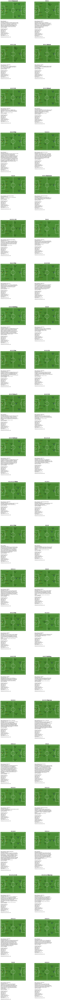

In [42]:
import matplotlib.pyplot as plt
from mplsoccer import Pitch
import textwrap

# Define positions and role colors
positions = {
    'GK': (40, 5),
    'LB': (10, 30), 'LCB': (25, 25), 'CB': (40, 25), 'RCB': (55, 25), 'RB': (70, 30),
    'LWB': (10, 30), 'RWB': (75, 30),
    'CDM': (40, 45), 'LDM': (25, 50), 'RDM': (55, 50),
    'CM': (40, 50), 'LCM': (25, 50), 'RCM': (55, 50),
    'LM': (10, 70), 'RM': (75, 70),
    'CAM': (40, 75), 'LAM': (25, 75), 'RAM': (55, 75),
    'LW': (10, 90), 'RW': (70, 90),
    'LF': (15, 85), 'RF': (65, 85),
    'LS': (25, 85), 'RS': (55, 85),
    'ST': (40, 95), 'CF': (40, 75),
    # New positions
    '1CB': (25, 25),
    '2CB': (55, 25),
    '3CB': (40, 25),
    '1CM': (25, 50),
    '2CM': (55, 50),
    '3CM': (40, 40),
    '1CAM': (15, 75),
    '2CAM': (65, 75),
    '1ST': (25, 95),
    '2ST': (55, 95),
    "1CDM": (25, 45),
    "2CDM": (55, 45)
}

role_colors = {
    'GK': 'orange',
    'LB': 'yellow', 'LCB': 'yellow', 'CB': 'yellow', 'RCB': 'yellow', 'RB': 'yellow',
    'LWB': 'yellow', 'RWB': 'yellow',
    'CDM': 'green', 'LDM': 'green', 'RDM': 'green',
    'CM': 'green', 'LCM': 'green', 'RCM': 'green',
    'LM': 'green', 'RM': 'green',
    'CAM': 'green', 'LAM': 'green', 'RAM': 'green',
    'LW': 'blue', 'RW': 'blue',
    'LF': 'blue', 'RF': 'blue',
    'LS': 'blue', 'RS': 'blue',
    'ST': 'blue', 'CF': 'blue',
    # New role colors
    '1CB': 'yellow',
    '2CB': 'yellow',
    '3CB': 'yellow',
    '1CM': 'green',
    '2CM': 'green',
    '3CM': 'green',
    '1ST': 'blue',
    '2ST': 'blue',
    '1CAM': 'green',
    '2CAM': 'green',
    '1CDM': 'green',
    '2CDM': 'green'
}

import matplotlib.pyplot as plt
from mplsoccer import Pitch
import textwrap


def wrap_text(text, width):
    return "\n".join(textwrap.wrap(text, width=width))

def parse_parameters(params_list):
    titles = [
        "possession_play", "counter_attack", "high_press", "direct_play",
        "wing_play", "set_piece_focus", "creative_playmaking", "playing_out_back",
        "low_block", "high_defensive_line"
    ]
    return dict(zip(titles, params_list))

def plot_formation(formation_name, lineup, score, details, params_list, predicted_success_score, ax):
    pitch = Pitch(pitch_type='statsbomb', pitch_color='grass', line_color='white')
    pitch.draw(ax=ax)
    
    # Place the players on the pitch with the respective colors
    for pos, players in lineup.items():
        if pos in positions:
            x, y = positions[pos]
            color = role_colors.get(pos, 'white')  # Default to white if not found in role_colors
            for player in players:
                if player:
                    ax.scatter(y, x, s=100, color=color, edgecolor='black', linewidth=2, zorder=2)  # Draw circle with color
                    ax.text(y, x-5, player, ha='center', va='center', fontsize=10, color='black', zorder=3, bbox=dict(facecolor='none', edgecolor='none', alpha=0.6))

    # Wrap and add formation details below the pitch
    mode = wrap_text(f"Mode: {details['Mode']}", 50)
    base = wrap_text(f"Formation Base: {details['Formation Base']}", 50)
    description = wrap_text(f"Description: {details['Description']}", 50)
    counter = wrap_text(f"Counter Formations: {details['Counter Formations']}", 50)
    score_text = f"{score:.4f}"
    
    # Extract and format parameters
    params = parse_parameters(params_list)
    param_text = "\n".join([f"{title}: {params[title]}" for title in params])

    # Add predicted success score
    success_score_text = f"Predicted Success Score: {predicted_success_score}"

    # Combine all details into one text block
    details_text = (f"{mode}\n{base}\n{description}\n{counter}\nScore: {score_text}\n\n{param_text}\n\n{success_score_text}")

    # Add formation details with bold title
    ax.text(0.01, -0.1, f"{details_text}",
            fontsize=12, va='top', ha='left', bbox=dict(facecolor='white', edgecolor='none', alpha=0.6),
            transform=ax.transAxes, zorder=3)

# Update the plotting loop
num_formations = len(formations)
fig, axes = plt.subplots((num_formations // 2) + 1, 2, figsize=(20, (num_formations // 2) * 10), constrained_layout=False)  # Adjust figure height as needed
axes = axes.flatten()

for i, formation in enumerate(formations):
    ax = axes[i]
    formation_name = formation['Formation']
    lineup = formation['Lineup']
    score = formation['Score']
    params_list = formation['Parameters']  # Extract parameter list from the formation dictionary
    predicted_success_score = formation['Predicted Success Score']

    for formation_detail in formations1:
        if formation_detail['Formation'] == formation_name:
            details = {
                'Mode': formation_detail['Mode'],
                'Formation Base': formation_detail['Formation Base'],
                'Description': formation_detail['Description'],
                'Counter Formations': formation_detail['Counter Formations']
            }
            break

    # Set title and plot the formation
    ax.set_title(formation_name, fontsize=20, fontweight='bold')
    plot_formation(formation_name, lineup, score, details, params_list, predicted_success_score, ax)

# Hide any unused subplots
for i in range(num_formations, len(axes)):
    fig.delaxes(axes[i])

# Adjust the layout to make space for text
fig.subplots_adjust(hspace=1.5, top=1.1, bottom=0.001)  # Adjust the hspace and bottom margin to accommodate text

plt.show()
